<a href="https://colab.research.google.com/github/mohamed0998/test-technique/blob/master/Immobilier.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Preprocessing
Dans cette partie je vais essayer d
le processus de correction des valeurs divergentes et autres informations incorrectes et non désirées.
1.   Nettoyage de la base de donnees
2.   Analyse exploratoire



In [ ]:
# importer les packages
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import missingno as msno
from google.colab import files
import plotly.graph_objs as go
from plotly.offline import iplot


from sklearn.preprocessing import LabelEncoder,StandardScaler
from sklearn.model_selection import StratifiedShuffleSplit

from sklearn.linear_model import LogisticRegression 
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier



from skmultilearn.problem_transform import BinaryRelevance
from skmultilearn.problem_transform import ClassifierChain
from skmultilearn.problem_transform import LabelPowerset

from sklearn.metrics import accuracy_score


#pip install scikit-multilearn

uploaded = files.upload()

Saving data_emmobilie.csv to data_emmobilie (1).csv


In [ ]:
pip install scikit-multilearn

     |████████████████████████████████| 89 kB 3.5 MB/s 


In [ ]:
df = pd.read_csv('data_emmobilie.csv')

In [ ]:
df

,ID,URL,CRAWL_SOURCE,PROPERTY_TYPE,NEW_BUILD,DESCRIPTION,IMAGES,SURFACE,LAND_SURFACE,BALCONY_SURFACE,TERRACE_SURFACE,ROOM_COUNT,BEDROOM_COUNT,BATHROOM_COUNT,LUNCHROOM_COUNT,TOILET_COUNT,FURNISHED,FIREPLACE,AIR_CONDITIONING,GARDEN,SWIMMING_POOL,BALCONY,TERRACE,CELLAR,PARKING,PARKING_COUNT,HEATING_TYPES,HEATING_MODE,FLOOR,FLOOR_COUNT,CONSTRUCTION_YEAR,ELEVATOR,CARETAKER,ENERGY_CONSUMPTION,GREENHOUSE_GAS_CONSUMPTION,MARKETING_TYPE,PRICE,PRICE_M2,PRICE_EVENTS,RENTAL_EXPENSES,RENTAL_EXPENSES_INCLUDED,DEPOSIT,FEES,FEES_INCLUDED,EXCLUSIVE_MANDATE,AGENCIES_UNWANTED,OCCUPIED,DEALER_NAME,DEALER_TYPE,CITY_ID,CITY,ZIP_CODE,DEPT_CODE,PUBLICATION_START_DATE,PUBLICATION_END_DATE,LAST_CRAWL_DATE,LAST_PRICE_DECREASE_DATE
0,22c05930-0eb5-11e7-b53d-bbead8ba43fe,http://www.avendrealouer.fr/location/levallois...,A_VENDRE_A_LOUER,APARTMENT,False,"Au rez de chaussée d'un bel immeuble récent,ap...","[""https://cf-medias.avendrealouer.fr/image/_87...",72.00,NaN,NaN,NaN,3.0,NaN,NaN,NaN,NaN,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,True,1.0,[],COLLECTIVE,NaN,NaN,NaN,True,NaN,NaN,NaN,RENT,1979.00,27.49,"[{""price"":1979,""date"":""2017-03-22""}]",276.00,True,NaN,NaN,NaN,False,NaN,NaN,Lamirand Et Associes,AGENCY,54178039,Levallois-Perret,92300.0,92,2017-03-22T04:07:56.095,NaN,2017-04-21T18:52:35.733,NaN
1,8d092fa0-bb99-11e8-a7c9-852783b5a69d,https://www.bienici.com/annonce/ag440414-16547...,BIEN_ICI,APARTMENT,False,Je vous propose un appartement dans la rue Col...,"[""http://photos.ubiflow.net/440414/165474561/p...",48.00,NaN,NaN,NaN,2.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,False,NaN,[],INDIVIDUAL,1.0,6.0,NaN,True,False,NaN,NaN,SALE,429000.00,8937.50,"[{""price"":452000.0,""date"":""2018-09-18""},{""pric...",NaN,NaN,NaN,NaN,False,False,NaN,False,Proprietes Privees,MANDATARY,54178039,Levallois-Perret,92300.0,92,2018-09-18T11:04:44.461,NaN,2019-06-06T10:08:10.89,2018-09-25
2,44b6a5c0-3466-11e9-8213-25cc7d9bf5fc,https://www.bellesdemeures.com/annonces/vente/...,BELLES_DEMEURES,APARTMENT,False,"Dans un cadre arboré, calme et fleuri, un pent...","[""https://v.seloger.com/s/width/965/visuels/0/...",267.00,NaN,NaN,NaN,6.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,NaN,[],NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,SALE,4970000.00,18614.23,"[{""price"":4970000.0,""date"":""2019-02-19""}]",NaN,NaN,NaN,NaN,NaN,False,NaN,False,Propriétés Parisiennes,AGENCY,54178039,Levallois-Perret,92300.0,92,2019-02-19T16:49:03.547,NaN,2019-06-13T08:22:14.314,NaN
3,e9e07ed0-812f-11e8-82aa-61eacebe4584,https://www.seloger.com/annonces/locations/bur...,SE_LOGER,PREMISES,False,"""Le meilleur coworking flexible de la ville, 5...","[""https://pix.yanport.com/ads/e9e07ed0-812f-11...",50.00,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,NaN,[],NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,RENT,89.00,1.78,"[{""price"":89.0,""date"":""2018-07-06""}]",NaN,NaN,NaN,NaN,NaN,False,NaN,NaN,Iwg,AGENCY,54178039,Levallois-Perret,92300.0,92,2018-07-06T15:18:59.805,NaN,2019-06-18T10:40:07.405,NaN
4,872302b0-5a21-11e9-950c-510fefc1ed35,https://www.bellesdemeures.com/annonces/vente/...,BELLES_DEMEURES,HOUSE,False,Levallois - Parc de la Planchette A toute prox...,"[""https://v.seloger.com/s/width/966/visuels/0/...",330.00,NaN,NaN,NaN,8.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,NaN,[],NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,SALE,2790000.00,8454.55,"[{""price"":3150000.0,""date"":""2019-04-08""},{""pri...",NaN,NaN,NaN,NaN,NaN,False,NaN,False,Daniel Feau Neuilly,AGENCY,54178039,Levallois-Perret,92300.0,92,2019-04-08T17:12:20.123,NaN,2019-06-14T15:02:18.155,2019-06-14
5,de04afa0-2e5f-11e8-bda5-3334b193df7f,https://immobilier.lefigaro.fr/annonces/annonc...,EXPLORIMMO,APARTMENT,False,LEVALLOIS - FRONT DE SEINE - 5-6 PIECES Appart...,"[""http://photo3.pericles.fr/photo_get.php?S1=3...",142.76,NaN,NaN,NaN,5.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,False,NaN,[],NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,SALE,1420000.00,9946.76,"[{""price"":1420000.0,""date"":""2018-03-23""}]",NaN,NaN,NaN,NaN,False,

In [ ]:
df.describe()

,SURFACE,LAND_SURFACE,BALCONY_SURFACE,TERRACE_SURFACE,ROOM_COUNT,BEDROOM_COUNT,BATHROOM_COUNT,LUNCHROOM_COUNT,TOILET_COUNT,FIREPLACE,AIR_CONDITIONING,GARDEN,SWIMMING_POOL,BALCONY,TERRACE,CELLAR,PARKING_COUNT,FLOOR,FLOOR_COUNT,CONSTRUCTION_YEAR,ENERGY_CONSUMPTION,GREENHOUSE_GAS_CONSUMPTION,PRICE,PRICE_M2,RENTAL_EXPENSES,DEPOSIT,FEES,CITY_ID,ZIP_CODE,DEPT_CODE,PUBLICATION_END_DATE
count,2050.000000,3.000000,0.0,25.000000,1835.000000,696.000000,0.0,0.0,0.0,0.0,0.0,14.0,6.0,0.0,86.0,0.0,157.000000,660.000000,465.000000,503.000000,0.0,0.0,2.104000e+03,1991.000000,441.000000,55.000000,94.000000,2164.0,2163.0,2164.0,0.0
mean,128.136068,30.000000,NaN,31.363600,2.243597,1.847701,NaN,NaN,NaN,NaN,NaN,1.0,1.0,NaN,1.0,NaN,1.605096,2.916667,5.827957,1965.081511,NaN,NaN,4.261142e+05,5483.773420,406.687347,2988.506000,1531.935957,54178039.0,92300.0,92.0,NaN
std,423.339898,8.660254,NaN,57.467242,1.715621,1.104508,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,0.0,NaN,1.299694,2.123793,2.432820,37.403519,NaN,NaN,6.486603e+05,5384.760624,1329.451157,8071.172419,6269.065130,0.0,0.0,0.0,NaN
min,6.000000,25.000000,NaN,5.590000,0.000000,1.000000,NaN,NaN,NaN,NaN,NaN,1.0,1.0,NaN,1.0,NaN,1.000000,0.000000,0.000000,1870.000000,NaN,NaN,3.300000e+01,1.780000,2.000000,70.000000,29.500000,54178039.0,92300.0,92.0,NaN
25%,36.200000,25.000000,NaN,13.000000,1.000000,1.000000,NaN,NaN,NaN,NaN,NaN,1.0,1.0,NaN,1.0,NaN,1.000000,1.000000,5.000000,1930.000000,NaN,NaN,1.600000e+03,32.375000,60.000000,860.500000,378.000000,54178039.0,92300.0,92.0,NaN
50%,55.000000,25.000000,NaN,18.000000,2.000000,1.000000,NaN,NaN,NaN,NaN,NaN,1.0,1.0,NaN,1.0,NaN,1.000000,2.000000,6.000000,1976.000000,NaN,NaN,2.200000e+05,7586.210000,100.000000,1350.000000,639.670000,54178039.0,92300.0,92.0,NaN
75%,93.000000,32.500000,NaN,26.000000,3.000000,2.000000,NaN,NaN,NaN,NaN,NaN,1.0,1.0,NaN,1.0,NaN,2.000000,4.000000,7.000000,1997.000000,NaN,NaN,6.097500e+05,10056.750000,151.000000,2450.000000,806.700000,54178039.0,92300.0,92.0,NaN
max,10287.000000,40.000000,NaN,300.000000,10.000000,8.000000,NaN,NaN,NaN,NaN,NaN,1.0,1.0,NaN,1.0,NaN,9.000000,14.000000,19.000000,2021.000000,NaN,NaN,6.000000e+06,89000.000000,14287.330000,60000.000000,60000.000000,54178039.0,92300.0,92.0,NaN


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2164 entries, 0 to 2163
Data columns (total 57 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   ID                          2164 non-null   object 
 1   URL                         2164 non-null   object 
 2   CRAWL_SOURCE                2164 non-null   object 
 3   PROPERTY_TYPE               2164 non-null   object 
 4   NEW_BUILD                   1973 non-null   object 
 5   DESCRIPTION                 2160 non-null   object 
 6   IMAGES                      2164 non-null   object 
 7   SURFACE                     2050 non-null   float64
 8   LAND_SURFACE                3 non-null      float64
 9   BALCONY_SURFACE             0 non-null      float64
 10  TERRACE_SURFACE             25 non-null     float64
 11  ROOM_COUNT                  1835 non-null   float64
 12  BEDROOM_COUNT               696 non-null    float64
 13  BATHROOM_COUNT              0 non

In [ ]:
pd.options.display.max_columns = None
pd.options.display.max_rows = None

# forme de dataframe

In [ ]:
shape = df.shape
print('\nDataFrame Shape :', shape)
print('\nNumber of rows :', shape[0])
print('\nNumber of columns :', shape[1])


DataFrame Shape : (2164, 57)

Number of rows : 2164

Number of columns : 57


# Obtenir toutes les valeurs nulles dans notre ensemble de données

In [ ]:
df.isnull().sum().sort_values(ascending=False)

FIREPLACE                     2164
LUNCHROOM_COUNT               2164
GREENHOUSE_GAS_CONSUMPTION    2164
ENERGY_CONSUMPTION            2164
AIR_CONDITIONING              2164
CELLAR                        2164
TOILET_COUNT                  2164
BALCONY                       2164
BATHROOM_COUNT                2164
BALCONY_SURFACE               2164
PUBLICATION_END_DATE          2164
LAND_SURFACE                  2161
SWIMMING_POOL                 2158
GARDEN                        2150
TERRACE_SURFACE               2139
DEPOSIT                       2109
TERRACE                       2078
FEES                          2070
PARKING_COUNT                 2007
AGENCIES_UNWANTED             1963
CARETAKER                     1917
LAST_PRICE_DECREASE_DATE      1824
RENTAL_EXPENSES               1723
FLOOR_COUNT                   1699
FURNISHED                     1697
CONSTRUCTION_YEAR             1661
FEES_INCLUDED                 1653
ELEVATOR                      1612
RENTAL_EXPENSES_INCL

### ci-dessous, nous traçons le premier graphique matriciel montrant la distribution des valeurs manquantes :

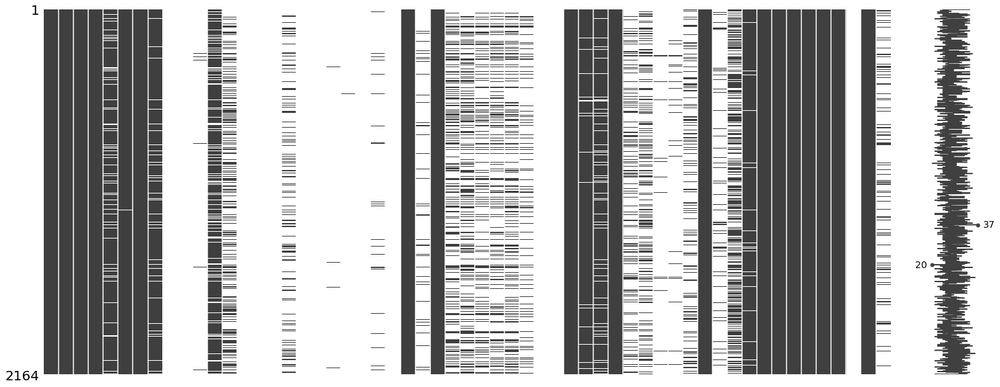

In [ ]:
#pip install missingo
msno.matrix(df)

## On remarque q'il y a plusieurs valeurs manquantes dans notre base de données

# traiter les valeurs nulles :

### Supprimez les colonnes qui contiennent plus de  50 % des valeurs nulles :

In [ ]:
df = df.drop(df.columns[df.apply(lambda col: col.isnull().sum() >= 2164/2)], axis=1)
df.isnull().sum().sort_values(ascending=False)

OCCUPIED                  955
ROOM_COUNT                329
NEW_BUILD                 191
PRICE_M2                  173
SURFACE                   114
DEALER_NAME                87
PRICE                      60
DESCRIPTION                 4
ZIP_CODE                    1
PARKING                     0
URL                         0
CRAWL_SOURCE                0
PROPERTY_TYPE               0
IMAGES                      0
LAST_CRAWL_DATE             0
HEATING_TYPES               0
MARKETING_TYPE              0
PUBLICATION_START_DATE      0
PRICE_EVENTS                0
EXCLUSIVE_MANDATE           0
DEALER_TYPE                 0
CITY_ID                     0
CITY                        0
DEPT_CODE                   0
ID                          0
dtype: int64

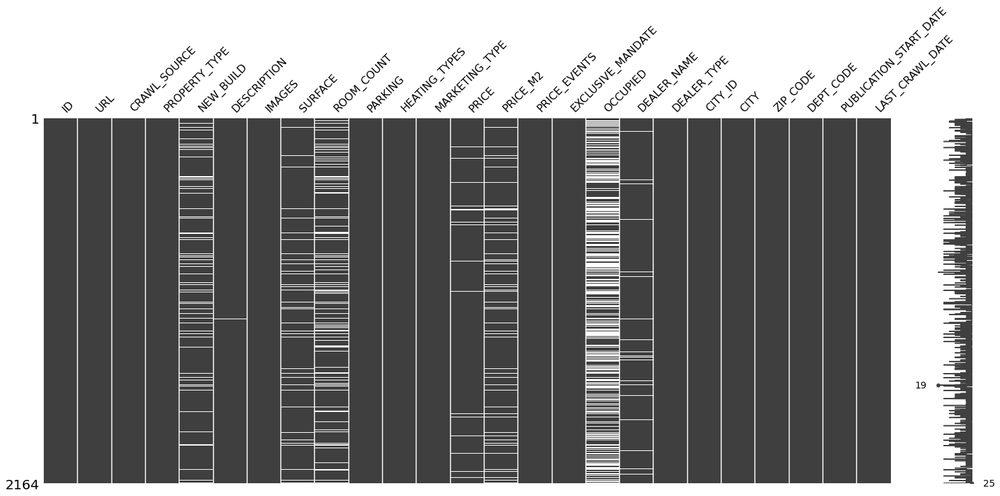

In [ ]:
msno.matrix(df)

### Ci-dessous, nous traçons le nombre de valeurs par colonnes en ignorant les valeurs manquantes apres la suppression :

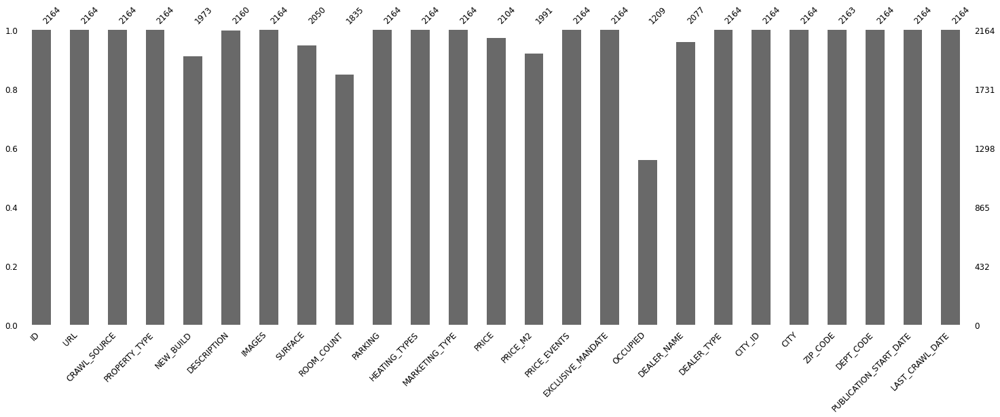

In [ ]:
msno.bar(df, figsize=(25,8), fontsize=12);

In [ ]:
df.describe()

,SURFACE,ROOM_COUNT,PRICE,PRICE_M2,CITY_ID,ZIP_CODE,DEPT_CODE
count,2050.000000,1835.000000,2.104000e+03,1991.000000,2164.0,2163.0,2164.0
mean,128.136068,2.243597,4.261142e+05,5483.773420,54178039.0,92300.0,92.0
std,423.339898,1.715621,6.486603e+05,5384.760624,0.0,0.0,0.0
min,6.000000,0.000000,3.300000e+01,1.780000,54178039.0,92300.0,92.0
25%,36.200000,1.000000,1.600000e+03,32.375000,54178039.0,92300.0,92.0
50%,55.000000,2.000000,2.200000e+05,7586.210000,54178039.0,92300.0,92.0
75%,93.000000,3.000000,6.097500e+05,10056.750000,54178039.0,92300.0,92.0
max,10287.000000,10.000000,6.000000e+06,89000.000000,54178039.0,92300.0,92.0


In [ ]:
df.describe(include='O')

,ID,URL,CRAWL_SOURCE,PROPERTY_TYPE,NEW_BUILD,DESCRIPTION,IMAGES,HEATING_TYPES,MARKETING_TYPE,PRICE_EVENTS,OCCUPIED,DEALER_NAME,DEALER_TYPE,CITY,PUBLICATION_START_DATE,LAST_CRAWL_DATE
count,2164,2164,2164,2164,1973,2160,2164,2164,2164,2164,1209,2077,2164,2164,2164,2164
unique,2164,2164,13,5,2,1914,1947,5,2,1733,2,553,3,1,2103,2164
top,f93705f0-cce5-11e8-98e8-37cca4ae64d7,https://www.meilleursagents.com/annonces/locat...,SE_LOGER,APARTMENT,False,Une adresse de choix pour devenir propriétaire...,[],[],SALE,"[{""price"":1250.0,""date"":""2019-08-21""}]",False,Building Partners,AGENCY,Levallois-Perret,2019-08-08T11:53:00,2019-08-13T04:46:23.358
freq,1,1,877,1436,1870,43,115,1832,1219,6,1189,144,1854,2164,11,1


# En analysant le tableau si-dessus on observe la valeur unique de chaque  colonnes, les colonnes dont toutes les valeurs sont les memes, on les supprime


In [ ]:
df.drop(['CITY_ID', 'CITY', 'ZIP_CODE', 'DEPT_CODE'], axis=1, inplace=True)

on supprime les colonnes images, URL et ID, car ils sont pas vraiment significants 

In [ ]:
df.drop(['URL', 'ID', 'IMAGES'], axis=1, inplace=True)

In [ ]:
df.drop(['PUBLICATION_START_DATE', 'LAST_CRAWL_DATE'], axis=1, inplace=True)

In [ ]:
df.drop(['PRICE_EVENTS'], axis=1, inplace=True)


In [ ]:
df.drop(['HEATING_TYPES'], axis=1, inplace=True)

In [ ]:
df.drop(['DESCRIPTION'], axis=1, inplace=True)

In [ ]:
df['OCCUPIED'].unique()

array([nan, False, True], dtype=object)

In [ ]:
df

,CRAWL_SOURCE,PROPERTY_TYPE,NEW_BUILD,SURFACE,ROOM_COUNT,PARKING,MARKETING_TYPE,PRICE,PRICE_M2,EXCLUSIVE_MANDATE,OCCUPIED,DEALER_NAME,DEALER_TYPE
0,A_VENDRE_A_LOUER,APARTMENT,False,72.00,3.0,True,RENT,1979.00,27.49,False,NaN,Lamirand Et Associes,AGENCY
1,BIEN_ICI,APARTMENT,False,48.00,2.0,False,SALE,429000.00,8937.50,False,False,Proprietes Privees,MANDATARY
2,BELLES_DEMEURES,APARTMENT,False,267.00,6.0,False,SALE,4970000.00,18614.23,False,False,Propriétés Parisiennes,AGENCY
3,SE_LOGER,PREMISES,False,50.00,0.0,False,RENT,89.00,1.78,False,NaN,Iwg,AGENCY
4,BELLES_DEMEURES,HOUSE,False,330.00,8.0,False,SALE,2790000.00,8454.55,False,False,Daniel Feau Neuilly,AGENCY
5,EXPLORIMMO,APARTMENT,False,142.76,5.0,False,SALE,1420000.00,9946.76,False,False,Building Partners,AGENCY
6,SE_LOGER,PREMISES,False,63.00,0.0,False,RENT,1740.00,27.62,False,NaN,Cabinet De L''ouest Parisien,AGENCY
7,EXPLORIMMO,PARKING,NaN,16.00,NaN,False,RENT,60.00,3.75,False,NaN,Yespark,AGENCY
8,LE_BON_COIN,PARKING,NaN,11.00,NaN,False,RENT,100.00,9.09,False,NaN,baudoin,PRIVATE
9,LE_BON_COIN,APARTMENT,False,57.00,2.0,False,SALE,570000.00,10000.00,False,False,Impact Immo,AGENCY


# get dummies

### Pour chaque valeur distincte de votre colonne catégorielle d'origine, créez une nouvelle colonne avec un indicateur (0 ou 1)

In [ ]:
df['PROPERTY_TYPE'].unique()

array(['APARTMENT', 'PREMISES', 'HOUSE', 'PARKING', 'BUILDING'],
      dtype=object)

In [ ]:
df['DEALER_TYPE'].unique()

array(['AGENCY', 'MANDATARY', 'PRIVATE'], dtype=object)

In [ ]:
property_types = pd.get_dummies(df['PROPERTY_TYPE'])
dealer_types = pd.get_dummies(df['DEALER_TYPE'])

In [ ]:
property_types['check'] = property_types.sum(axis=1)
dealer_types['check'] = dealer_types.sum(axis=1)

In [ ]:
property_types

,APARTMENT,BUILDING,HOUSE,PARKING,PREMISES,check
0,1,0,0,0,0,1
1,1,0,0,0,0,1
2,1,0,0,0,0,1
3,0,0,0,0,1,1
4,0,0,1,0,0,1
5,1,0,0,0,0,1
6,0,0,0,0,1,1
7,0,0,0,1,0,1
8,0,0,0,1,0,1
9,1,0,0,0,0,1


In [ ]:
dealer_types

,AGENCY,MANDATARY,PRIVATE,check
0,1,0,0,1
1,0,1,0,1
2,1,0,0,1
3,1,0,0,1
4,1,0,0,1
5,1,0,0,1
6,1,0,0,1
7,1,0,0,1
8,0,0,1,1
9,1,0,0,1


In [ ]:
# Vérifier si chaque immobilié a un et un seul type
property_types['check'].unique()

array([1])

In [ ]:
# Vérifier si chaque marchand a un et un seul type
dealer_types['check'].unique()

array([1])

In [ ]:
property_types = property_types.drop(['check'], axis = 1)
dealer_types = dealer_types.drop(['check'], axis = 1)

In [ ]:
property_types = pd.get_dummies(df['PROPERTY_TYPE'])
dealer_types = pd.get_dummies(df['DEALER_TYPE'])

# Grouper les types des immobiliers :

In [ ]:
# supprimer les deux colonnes PROPERTY_TYPE et DEALER_TYPE
df.drop(['PROPERTY_TYPE'], axis = 1, inplace= True)
df.drop(['DEALER_TYPE'], axis = 1, inplace= True)

# Concaténer les valeurs des colonnes

In [ ]:
df = pd.concat([property_types,df,dealer_types], axis = 1)
df

,APARTMENT,BUILDING,HOUSE,PARKING,PREMISES,CRAWL_SOURCE,NEW_BUILD,SURFACE,ROOM_COUNT,PARKING,MARKETING_TYPE,PRICE,PRICE_M2,EXCLUSIVE_MANDATE,OCCUPIED,DEALER_NAME,AGENCY,MANDATARY,PRIVATE
0,1,0,0,0,0,A_VENDRE_A_LOUER,False,72.00,3.0,True,RENT,1979.00,27.49,False,NaN,Lamirand Et Associes,1,0,0
1,1,0,0,0,0,BIEN_ICI,False,48.00,2.0,False,SALE,429000.00,8937.50,False,False,Proprietes Privees,0,1,0
2,1,0,0,0,0,BELLES_DEMEURES,False,267.00,6.0,False,SALE,4970000.00,18614.23,False,False,Propriétés Parisiennes,1,0,0
3,0,0,0,0,1,SE_LOGER,False,50.00,0.0,False,RENT,89.00,1.78,False,NaN,Iwg,1,0,0
4,0,0,1,0,0,BELLES_DEMEURES,False,330.00,8.0,False,SALE,2790000.00,8454.55,False,False,Daniel Feau Neuilly,1,0,0
5,1,0,0,0,0,EXPLORIMMO,False,142.76,5.0,False,SALE,1420000.00,9946.76,False,False,Building Partners,1,0,0
6,0,0,0,0,1,SE_LOGER,False,63.00,0.0,False,RENT,1740.00,27.62,False,NaN,Cabinet De L''ouest Parisien,1,0,0
7,0,0,0,1,0,EXPLORIMMO,NaN,16.00,NaN,False,RENT,60.00,3.75,False,NaN,Yespark,1,0,0
8,0,0,0,1,0,LE_BON_COIN,NaN,11.00,NaN,False,RENT,100.00,9.09,False,NaN,baudoin,0,0,1
9,1,0,0,0,0,LE_BON_COIN,False,57.00,2.0,False,SALE,570000.00,10000.00,False,False,Impact Immo,1,0,0


#Séparer les variables numériques avec les variables catégoriques

In [ ]:
cat_data=[]
num_data=[]
for i,c in enumerate(df.dtypes) :
    if c== object:
        cat_data.append(df.iloc[:,i])
    else:
        num_data.append(df.iloc[:,i])
        

        
cat_data=pd.DataFrame(cat_data)
num_data=pd.DataFrame(num_data)

cat_data=pd.DataFrame(cat_data.transpose())
num_data=pd.DataFrame(num_data.transpose())

In [ ]:
cat_data.head()

,CRAWL_SOURCE,NEW_BUILD,MARKETING_TYPE,OCCUPIED,DEALER_NAME
0,A_VENDRE_A_LOUER,False,RENT,NaN,Lamirand Et Associes
1,BIEN_ICI,False,SALE,False,Proprietes Privees
2,BELLES_DEMEURES,False,SALE,False,Propriétés Parisiennes
3,SE_LOGER,False,RENT,NaN,Iwg
4,BELLES_DEMEURES,False,SALE,False,Daniel Feau Neuilly


In [ ]:
num_data.head()

,APARTMENT,BUILDING,HOUSE,PARKING,PREMISES,SURFACE,ROOM_COUNT,PARKING,PRICE,PRICE_M2,EXCLUSIVE_MANDATE,AGENCY,MANDATARY,PRIVATE
0,1.0,0.0,0.0,0.0,0.0,72.0,3.0,1.0,1979.0,27.49,0.0,1.0,0.0,0.0
1,1.0,0.0,0.0,0.0,0.0,48.0,2.0,0.0,429000.0,8937.50,0.0,0.0,1.0,0.0
2,1.0,0.0,0.0,0.0,0.0,267.0,6.0,0.0,4970000.0,18614.23,0.0,1.0,0.0,0.0
3,0.0,0.0,0.0,0.0,1.0,50.0,0.0,0.0,89.0,1.78,0.0,1.0,0.0,0.0
4,0.0,0.0,1.0,0.0,0.0,330.0,8.0,0.0,2790000.0,8454.55,0.0,1.0,0.0,0.0


# pour les variables catoriques on va remplacer les valeurs manquantes par les valeurs les plus fréquentes

In [ ]:
cat_data=cat_data.apply(lambda x:x.fillna(x.value_counts().index[0]))

In [ ]:
cat_data.isnull().sum().any()

False

In [ ]:
cat_data.head()

,CRAWL_SOURCE,NEW_BUILD,MARKETING_TYPE,OCCUPIED,DEALER_NAME
0,A_VENDRE_A_LOUER,False,RENT,False,Lamirand Et Associes
1,BIEN_ICI,False,SALE,False,Proprietes Privees
2,BELLES_DEMEURES,False,SALE,False,Propriétés Parisiennes
3,SE_LOGER,False,RENT,False,Iwg
4,BELLES_DEMEURES,False,SALE,False,Daniel Feau Neuilly


# pour les variables numériques on va remplacer les valeurs manquantes par la valeur précendente de la meme colonne

In [ ]:
num_data.fillna(method= 'bfill', inplace=True)
num_data.isnull().sum().any()

False

In [ ]:
num_data.head()

,APARTMENT,BUILDING,HOUSE,PARKING,PREMISES,SURFACE,ROOM_COUNT,PARKING,PRICE,PRICE_M2,EXCLUSIVE_MANDATE,AGENCY,MANDATARY,PRIVATE
0,1.0,0.0,0.0,0.0,0.0,72.0,3.0,1.0,1979.0,27.49,0.0,1.0,0.0,0.0
1,1.0,0.0,0.0,0.0,0.0,48.0,2.0,0.0,429000.0,8937.50,0.0,0.0,1.0,0.0
2,1.0,0.0,0.0,0.0,0.0,267.0,6.0,0.0,4970000.0,18614.23,0.0,1.0,0.0,0.0
3,0.0,0.0,0.0,0.0,1.0,50.0,0.0,0.0,89.0,1.78,0.0,1.0,0.0,0.0
4,0.0,0.0,1.0,0.0,0.0,330.0,8.0,0.0,2790000.0,8454.55,0.0,1.0,0.0,0.0


# On va encoder les valeurs des data categoriques pour qu'elles soient comprehensible par notre modele :

In [ ]:
le=LabelEncoder()
for i in cat_data:
    cat_data[i] = le.fit_transform(cat_data[i])
cat_data

,CRAWL_SOURCE,NEW_BUILD,MARKETING_TYPE,OCCUPIED,DEALER_NAME
0,0,0,0,0,297
1,2,0,1,0,422
2,1,0,1,0,423
3,11,0,0,0,269
4,1,0,1,0,164
5,3,0,1,0,87
6,11,0,0,0,100
7,3,0,0,0,505
8,4,0,0,0,512
9,4,0,1,0,262


# Concatener les variables numériques et les variables catégoriques

In [ ]:
x= pd.concat([cat_data,num_data],axis=1)

In [ ]:
x.head()

,CRAWL_SOURCE,NEW_BUILD,MARKETING_TYPE,OCCUPIED,DEALER_NAME,APARTMENT,BUILDING,HOUSE,PARKING,PREMISES,SURFACE,ROOM_COUNT,PARKING,PRICE,PRICE_M2,EXCLUSIVE_MANDATE,AGENCY,MANDATARY,PRIVATE
0,0,0,0,0,297,1.0,0.0,0.0,0.0,0.0,72.0,3.0,1.0,1979.0,27.49,0.0,1.0,0.0,0.0
1,2,0,1,0,422,1.0,0.0,0.0,0.0,0.0,48.0,2.0,0.0,429000.0,8937.50,0.0,0.0,1.0,0.0
2,1,0,1,0,423,1.0,0.0,0.0,0.0,0.0,267.0,6.0,0.0,4970000.0,18614.23,0.0,1.0,0.0,0.0
3,11,0,0,0,269,0.0,0.0,0.0,0.0,1.0,50.0,0.0,0.0,89.0,1.78,0.0,1.0,0.0,0.0
4,1,0,1,0,164,0.0,0.0,1.0,0.0,0.0,330.0,8.0,0.0,2790000.0,8454.55,0.0,1.0,0.0,0.0


# le  choix de target

## notre target sera le nom des sites, le but  principal de notre programme sera donc de prédire les différents sites sur laquelle il apparait une annonce donné

In [ ]:
target = x['CRAWL_SOURCE']
target.head()

0     0
1     2
2     1
3    11
4     1
Name: CRAWL_SOURCE, dtype: int64

# on va transformer notre colonne de CRAWL_SOURCE qui contiennent plusieurs classes en plusieurs colonnes dont chaque colonne contient un seul classe

In [ ]:
crawl_source = pd.get_dummies(x['CRAWL_SOURCE'])
target = crawl_source
target


,0,1,2,3,4,5,6,7,8,9,10,11,12
0,1,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,1,0,0,0,0,0,0,0,0,0,0
2,0,1,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,1,0
4,0,1,0,0,0,0,0,0,0,0,0,0,0
5,0,0,0,1,0,0,0,0,0,0,0,0,0
6,0,0,0,0,0,0,0,0,0,0,0,1,0
7,0,0,0,1,0,0,0,0,0,0,0,0,0
8,0,0,0,0,1,0,0,0,0,0,0,0,0
9,0,0,0,0,1,0,0,0,0,0,0,0,0


In [ ]:
#pip install chart_studio

     |████████████████████████████████| 64 kB 1.6 MB/s 


In [ ]:
x.groupby('CRAWL_SOURCE')['DEALER_NAME'].count()

CRAWL_SOURCE
0     208
1      19
2     178
3     196
4     246
5     137
6       7
7     193
8      49
9      31
10     21
11    877
12      2
Name: DEALER_NAME, dtype: int64

In [ ]:
trace1= go.Bar(
    x=x.groupby('CRAWL_SOURCE')['PRICE'].count().index,
    y=x.groupby('CRAWL_SOURCE')['PRICE'].count(),
   
)
iplot([trace1])

In [ ]:
x.head()

,CRAWL_SOURCE,NEW_BUILD,MARKETING_TYPE,OCCUPIED,DEALER_NAME,APARTMENT,BUILDING,HOUSE,PARKING,PREMISES,SURFACE,ROOM_COUNT,PARKING,PRICE,PRICE_M2,EXCLUSIVE_MANDATE,AGENCY,MANDATARY,PRIVATE
0,0,0,0,0,297,1.0,0.0,0.0,0.0,0.0,72.0,3.0,1.0,1979.0,27.49,0.0,1.0,0.0,0.0
1,2,0,1,0,422,1.0,0.0,0.0,0.0,0.0,48.0,2.0,0.0,429000.0,8937.50,0.0,0.0,1.0,0.0
2,1,0,1,0,423,1.0,0.0,0.0,0.0,0.0,267.0,6.0,0.0,4970000.0,18614.23,0.0,1.0,0.0,0.0
3,11,0,0,0,269,0.0,0.0,0.0,0.0,1.0,50.0,0.0,0.0,89.0,1.78,0.0,1.0,0.0,0.0
4,1,0,1,0,164,0.0,0.0,1.0,0.0,0.0,330.0,8.0,0.0,2790000.0,8454.55,0.0,1.0,0.0,0.0


In [ ]:
x.drop(['CRAWL_SOURCE'], axis=1, inplace=True)

#Standardiser les données
## la standarisation est l'un des outils de preprocessing les plus courants, car les données de magnitude différente peuvent être biaisées vers des valeurs élevées, nous voulons que toutes les entrées soient de magnitude similaire

In [ ]:
# un module très utile que nous pouvons utiliser est StandardScaler
# nous allons créer une variable qui contiendra les informations standarisées pour cet ensemble de données particulier
x_scaler = StandardScaler()

In [ ]:
x.columns.values

array(['NEW_BUILD', 'MARKETING_TYPE', 'OCCUPIED', 'DEALER_NAME',
       'APARTMENT', 'BUILDING', 'HOUSE', 'PARKING', 'PREMISES', 'SURFACE',
       'ROOM_COUNT', 'PARKING', 'PRICE', 'PRICE_M2', 'EXCLUSIVE_MANDATE',
       'AGENCY', 'MANDATARY', 'PRIVATE'], dtype=object)

In [ ]:
# on va exclure les colonnes qui contiennent les valeurs 0 et 1 de standarisation, car sinon on va avoir des nouvelles valeurs non-significantes
col_names =['DEALER_NAME','SURFACE','ROOM_COUNT','PRICE','PRICE_M2'] # colonnes a standariser

features = x[col_names]
scaler = StandardScaler().fit(features.values)
features = scaler.transform(features.values)
x[col_names] = features
x

,NEW_BUILD,MARKETING_TYPE,OCCUPIED,DEALER_NAME,APARTMENT,BUILDING,HOUSE,PARKING,PREMISES,SURFACE,ROOM_COUNT,PARKING,PRICE,PRICE_M2,EXCLUSIVE_MANDATE,AGENCY,MANDATARY,PRIVATE
0,0,0,0,0.441881,1.0,0.0,0.0,0.0,0.0,-0.131009,0.422417,1.0,-0.654264,-1.021656,0.0,1.0,0.0,0.0
1,0,1,0,1.306078,1.0,0.0,0.0,0.0,0.0,-0.189124,-0.155402,0.0,0.009917,0.636507,0.0,0.0,1.0,0.0
2,0,1,0,1.312991,1.0,0.0,0.0,0.0,0.0,0.341169,2.155873,0.0,7.072902,2.437357,0.0,1.0,0.0,0.0
3,0,0,0,0.248301,0.0,0.0,0.0,0.0,1.0,-0.184281,-1.311040,0.0,-0.657203,-1.026441,0.0,1.0,0.0,0.0
4,0,1,0,-0.477624,0.0,0.0,1.0,0.0,0.0,0.493719,3.311511,0.0,3.682172,0.546629,0.0,1.0,0.0,0.0
5,0,1,0,-1.009970,1.0,0.0,0.0,0.0,0.0,0.040331,1.578054,0.0,1.551299,0.824331,0.0,1.0,0.0,0.0
6,0,0,0,-0.920093,0.0,0.0,0.0,0.0,1.0,-0.152802,-1.311040,0.0,-0.654635,-1.021632,0.0,1.0,0.0,0.0
7,0,0,0,1.879904,0.0,0.0,0.0,1.0,0.0,-0.266609,-0.155402,0.0,-0.657248,-1.026074,0.0,1.0,0.0,0.0
8,0,0,0,1.928299,0.0,0.0,0.0,1.0,0.0,-0.278717,-0.155402,0.0,-0.657186,-1.025081,0.0,0.0,0.0,1.0
9,0,1,0,0.199906,1.0,0.0,0.0,0.0,0.0,-0.167331,-0.155402,0.0,0.229226,0.834239,0.0,1.0,0.0,0.0


In [ ]:
y = target
y

,0,1,2,3,4,5,6,7,8,9,10,11,12
0,1,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,1,0,0,0,0,0,0,0,0,0,0
2,0,1,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,1,0
4,0,1,0,0,0,0,0,0,0,0,0,0,0
5,0,0,0,1,0,0,0,0,0,0,0,0,0
6,0,0,0,0,0,0,0,0,0,0,0,1,0
7,0,0,0,1,0,0,0,0,0,0,0,0,0
8,0,0,0,0,1,0,0,0,0,0,0,0,0
9,0,0,0,0,1,0,0,0,0,0,0,0,0


# Maching learning

### Dans cette partie on va tester différents modeles de maching learning et aprés on va choisir celui qui nous donne les résultats de prediction les plus appropriés .
## un seul output :
### On va faire la prediction de chaque classe séparément, en utilisant les trois modeles : 
* logistic regression
* KNeighbors
*  DecisionTree


## Plusieurs outputs : 
On regroupe les classes et on va faire une classification multioutput qui support plusieurs outputs au meme temps, en utilisant les trois modeles :

* Binary relevance
* classifier chains
*  Label powerset








# Un seul output :

In [ ]:
# définir un dictionnaire qui contient les trois modeles :
models={'LogisticRegression': LogisticRegression(random_state=42),
       'KNeighborsClassifier': KNeighborsClassifier(),
       'DecisionTreeClassifier': DecisionTreeClassifier(max_depth=1, random_state=42)
}

In [ ]:
class Prediction :

 
  
  def __init__(self,x_train, x_test, y_train, y_test,models):

    self.x_train = x_train
    self.x_test = x_test
    self.y_train = y_train
    self.y_test = y_test
    self.models = models

  #a fonction de précision des modeles
  def accu(self,y_true,y_pred,retu=False):
    acc=accuracy_score(y_true,y_pred)
    if retu:
        return acc
    else:
        print(f'la precision du modele est: {acc}')

  #la fonction d'application des modeles
  def train_test_eval(self):
    for name,model in  self.models.items() :
        print(name,':')
        model.fit(self.x_train,self.y_train)
        self.accu(self.y_test,model.predict(self.x_test))
        print('-'*30)



  


In [ ]:
y.columns.values

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12])

## diviser notre data en data d'entrainement et data de test :

In [ ]:
#diviser et mélanger les données 
#on va utiliser 30 % de notre data pour le test

sss= StratifiedShuffleSplit(n_splits=1, test_size=0.2,random_state=42)

# le train et test de toutes le classes
for train,test in sss.split(x,y):

    x_train,x_test= x.iloc[train],x.iloc[test]
    y_train,y_test= y.iloc[train],y.iloc[test]

# le train et test chaque classe séparement
y_columns = [ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12]

ys_train= []
ys_test= []

for i in range(13) :

  ys_train.append(y_train[y_columns[i]])
  ys_test.append(y_test[y_columns[i]])



print('x_train taille:' , x_train.shape)
print('x_test taille:' , x_test.shape)
print('y_train taille:' , y_train.shape)
print('y_test taille:' , y_test.shape)

x_train taille: (1731, 18)
x_test taille: (433, 18)
y_train taille: (1731, 13)
y_test taille: (433, 13)


## Le test de chaque classe séparement :

In [ ]:
y_columns = ['A_VENDRE_A_LOUER', 'BELLES_DEMEURES', 'BIEN_ICI', 'EXPLORIMMO', 
             'LE_BON_COIN', 'LOGIC_IMMO', 'LUX_RESIDENCE', 'MEILLEURS_AGENTS',
             'PAP', 'PARU_VENDU', 'PROPRIETES_DE_FRANCE', 'SE_LOGER','SURFACE_PRIVEE']
for i in range (13) :
  predict_class= Prediction(x_train,x_test,ys_train[i],ys_test[i],models)
  print('-----------------------------------------'+ y_columns[i] +'-------------------------------------------------------------')
  predict_class.train_test_eval()
  print('-------------------------------------------------------------------------------------------------------------------')
  print('\n')


-----------------------------------------A_VENDRE_A_LOUER-------------------------------------------------------------
LogisticRegression :
la precision du modele est: 0.9030023094688222
------------------------------
KNeighborsClassifier :
la precision du modele est: 0.9030023094688222
------------------------------
DecisionTreeClassifier :
la precision du modele est: 0.9030023094688222
------------------------------
-------------------------------------------------------------------------------------------------------------------


-----------------------------------------BELLES_DEMEURES-------------------------------------------------------------
LogisticRegression :
la precision du modele est: 0.9930715935334873
------------------------------
KNeighborsClassifier :
la precision du modele est: 0.9907621247113164
------------------------------
DecisionTreeClassifier :
la precision du modele est: 0.9907621247113164
------------------------------
---------------------------------------

# Plusieurs outputs :

## Binary Relevance :

### Cette technique garantit que le classificateur  est entraîné sur toutes les combinaisons des classes possibles dans nos données.

In [ ]:
binary_rel_clf = BinaryRelevance(LogisticRegression())

In [ ]:
binary_rel_clf.fit(x_train,y_train)

BinaryRelevance(classifier=LogisticRegression(), require_dense=[True, True])

In [ ]:
br_prediction = binary_rel_clf.predict(x_test)
br_prediction

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:439: UserWarning:

X has feature names, but LogisticRegression was fitted without feature names

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:439: UserWarning:

X has feature names, but LogisticRegression was fitted without feature names

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:439: UserWarning:

X has feature names, but LogisticRegression was fitted without feature names

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:439: UserWarning:

X has feature names, but LogisticRegression was fitted without feature names

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:439: UserWarning:

X has feature names, but LogisticRegression was fitted without feature names

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:439: UserWarning:

X has feature names, but LogisticRegression was fitted without feature names

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:439: UserWarning:

X has feature 

<433x13 sparse matrix of type '<class 'numpy.uint8'>'
	with 137 stored elements in Compressed Sparse Column format>

In [ ]:
br_prediction.toarray()

array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 1, 0],
       [0, 0, 0, ..., 0, 1, 0]], dtype=uint8)

In [ ]:
accuracy_score(y_test,br_prediction)

0.24249422632794457

## Classifier chains

### Cette technique réserve la corrélation entre les classes, où une sortie d'un classificateur est utilisée comme entrée du classificateur suivant dans la chaîne. Ce processus se déroule dans un ordre séquentiel.

In [ ]:
def build_model(model,mlb_estimator,xtrain,ytrain,xtest,ytest):
    clf = mlb_estimator(model)
    clf.fit(xtrain,ytrain)
    clf_predictions = clf.predict(xtest)
    acc = accuracy_score(ytest,clf_predictions)
    ham = hamming_loss(ytest,clf_predictions)
    result = {"accuracy:":acc,"hamming_score":ham}
    return result

### Dans ce cas, nous utilisons LogisticRegression() comme algorithme de classification. Nous devons également initialiser notre méthode ClassifierChain() pour montrer qu'on utilise la technique de classifier chains


In [ ]:
from sklearn.metrics import accuracy_score,hamming_loss
clf_chain_model = build_model(LogisticRegression(),ClassifierChain,x_train,y_train,x_test,y_test)

In [ ]:
clf_chain_model

{'accuracy:': 0.47575057736720555, 'hamming_score': 0.08047610588026292}

## Labelpowerset

### Cette technique garantit que le classifieur est entraîné sur toutes les combinaisons de classes possibles dans nos données. Voyons voir comment ça fonctionne.

In [ ]:
clf_labelP_model = build_model(LogisticRegression(),LabelPowerset,x_train,y_train,x_test,y_test)

/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_logistic.py:818: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:439: UserWarning:

X has feature names, but LogisticRegression was fitted without feature names



In [ ]:
clf_labelP_model

{'accuracy:': 0.4665127020785219, 'hamming_score': 0.08207496891099662}

# Conclusion
### Apres avoir travallier avec les deux methodes un seul output et plusieurs outputs
### on constate que :
## **pour la methode d'un seul output :**
### On general les trois modeles prédire les resultats avec un fort precision c'est due au fait qu'on n'a qu'un seul classe qui implique un bon precision
### les trois modeles ont presque la meme precision qui un precision de plus de 98 %
## **pour la methode de plusieurs output :**
### On general les trois modeles prédire les resultats avec une precision faible c'est due  au fait qu'on n'a plusieurs classes (13 classes) alors qu'on n'a que 2164 lignes de données , c'est insuffisant en prenant en compte les nombres de classes, ce qui implique un precision tres bas. Cependant les deux modeles classifier chains et Label powerset sont mieux que le modele Binary Relevance en terme de precision.
